In [3]:
!du -hs /home/conda/Desktop/NoteBooks/GRAPHICS/superpixels/slicPython

4.7M	/home/conda/Desktop/NoteBooks/GRAPHICS/superpixels/slicPython


In [16]:
from IPython.core.display import HTML
HTML("""
<style>
#notebooks-container {
    padding: 15px;
    background-color: #ffebcd;
    min-height: 20px;
    width: 900px;
    -webkit-box-shadow: 0px 0px 12px 1px rgba(87, 87, 87, 0.3);
    box-shadow: 0px 0px 12px 1px rgba(87, 87, 87, 0.3);
}
</style>
<div id ="notebooks-container">
<h1>Notebook Container</h1>
<div/>
""")

# OR Edit
~/anaconda2/lib/python2.7/site-packages/notebook/static/custom

In [18]:
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io

%pylab inline
%matplotlib inline 


Populating the interactive namespace from numpy and matplotlib


In [19]:
!wget -O images/003.jpg https://jacknorthrup.com/INSTAGRAM/003.jpg

--2018-09-09 15:27:06--  https://jacknorthrup.com/INSTAGRAM/003.jpg
Resolving jacknorthrup.com (jacknorthrup.com)... 192.250.236.207
Connecting to jacknorthrup.com (jacknorthrup.com)|192.250.236.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 85760 (84K) [image/jpeg]
Saving to: ‘images/003.jpg’

images/003.jpg      100%[===================>]  83.75K  68.4KB/s    in 1.2s    

2018-09-09 15:27:09 (68.4 KB/s) - ‘images/003.jpg’ saved [85760/85760]



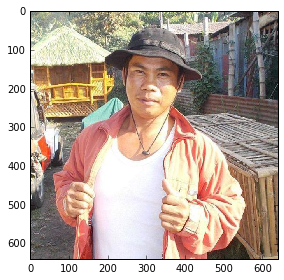

In [20]:
img = img_as_float(io.imread('images/003.jpg'))
io.imshow(img);

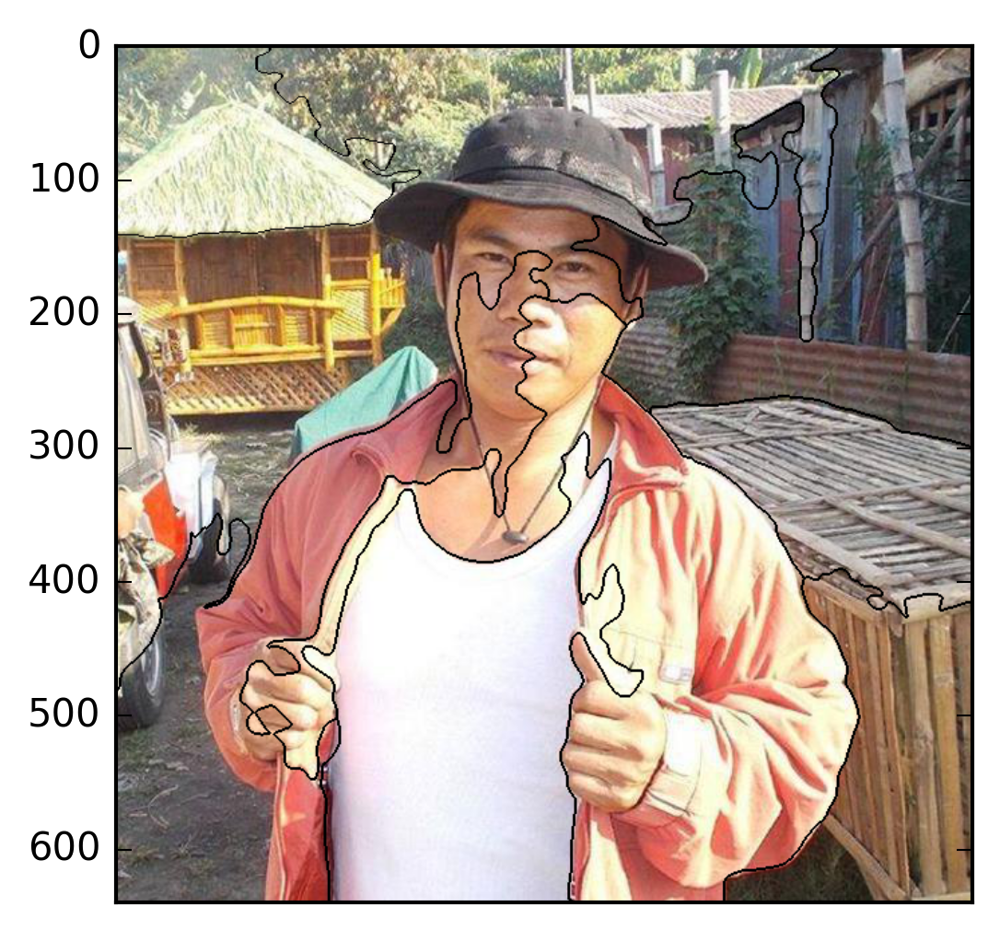

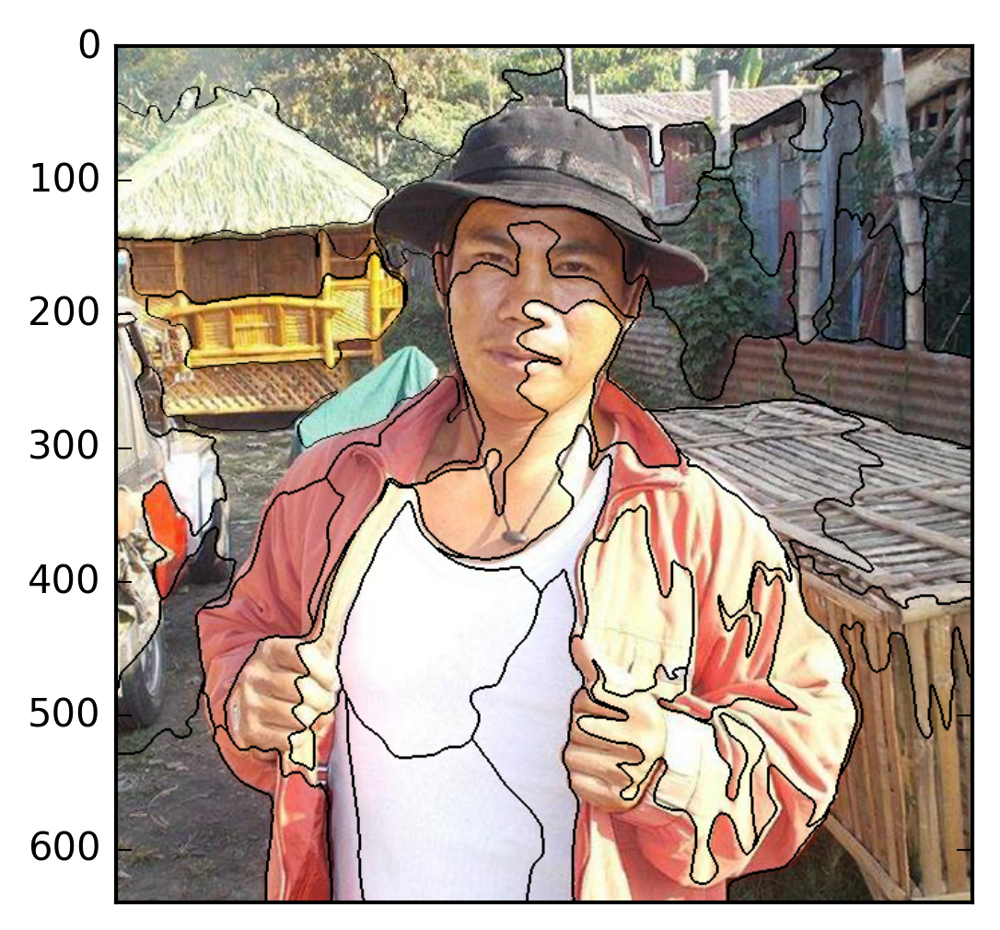

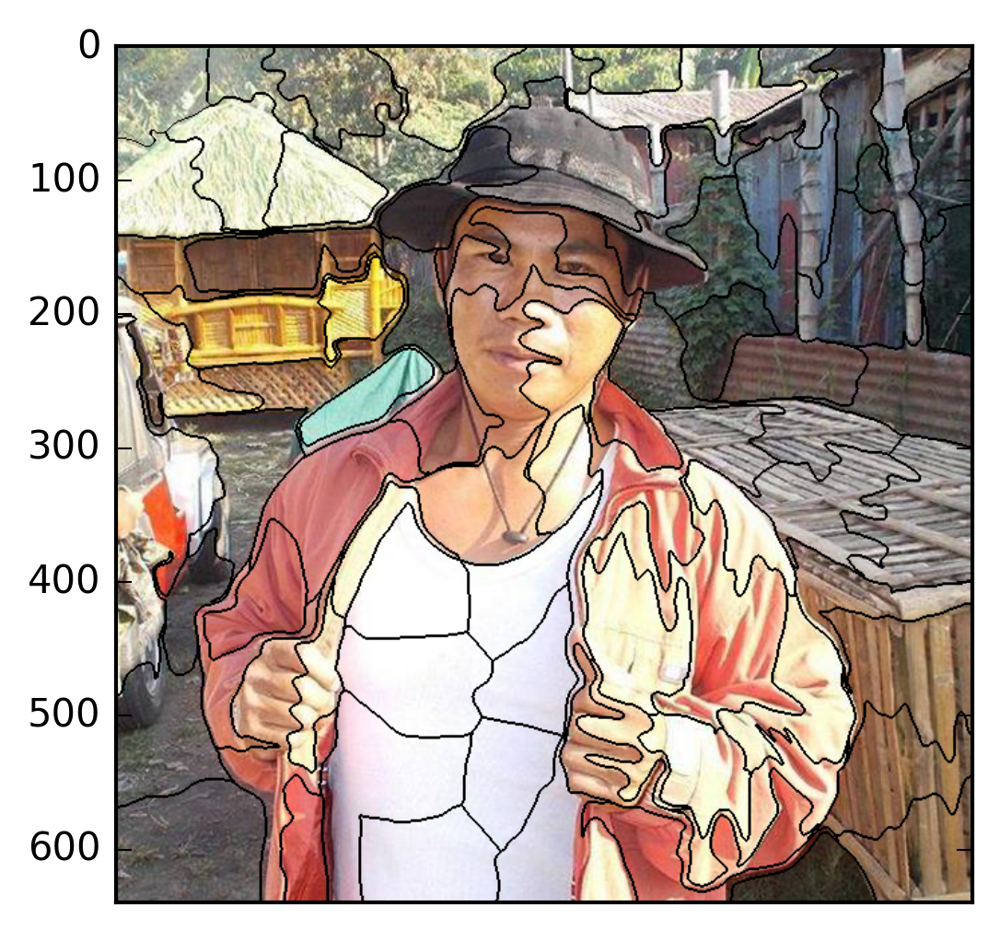

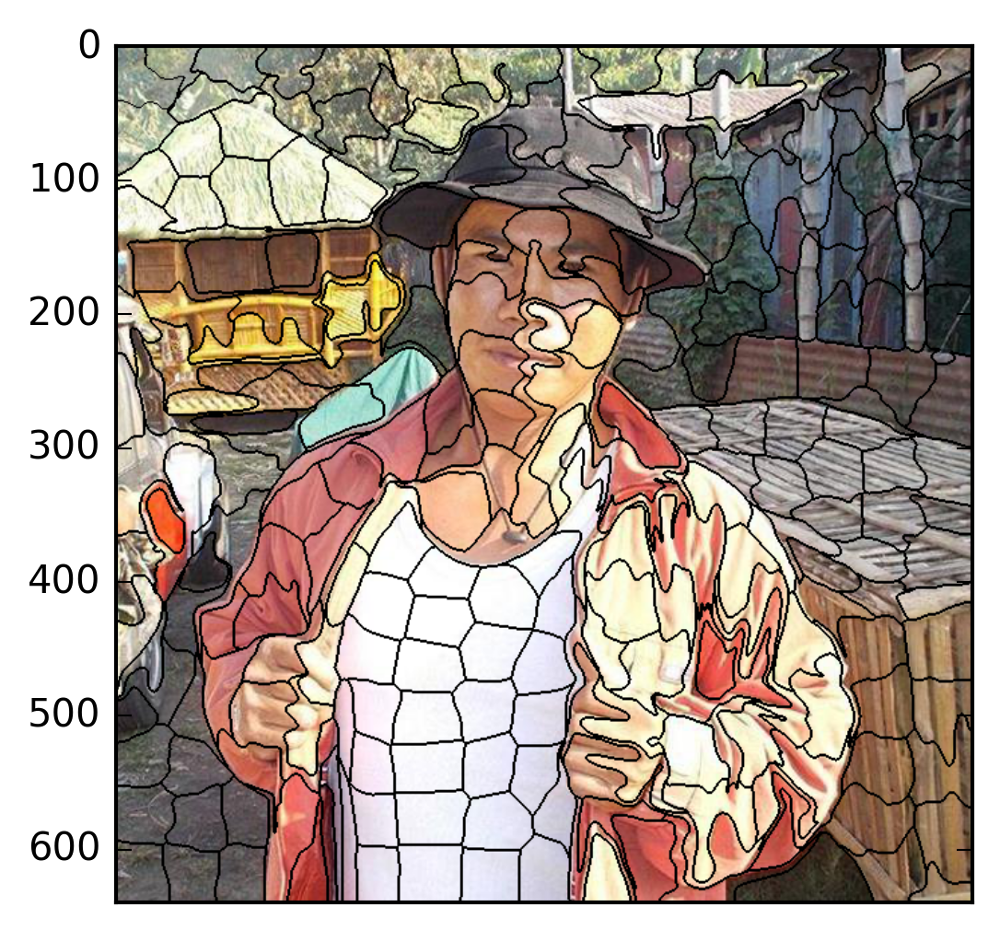

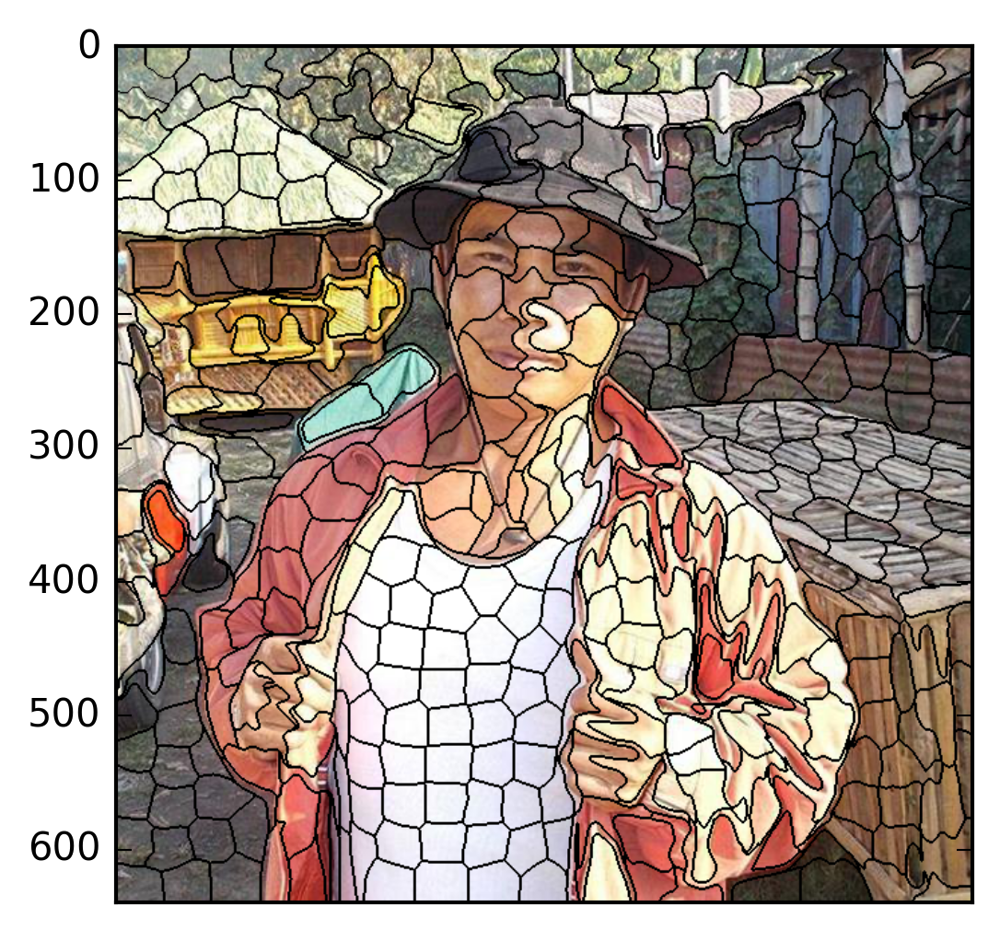

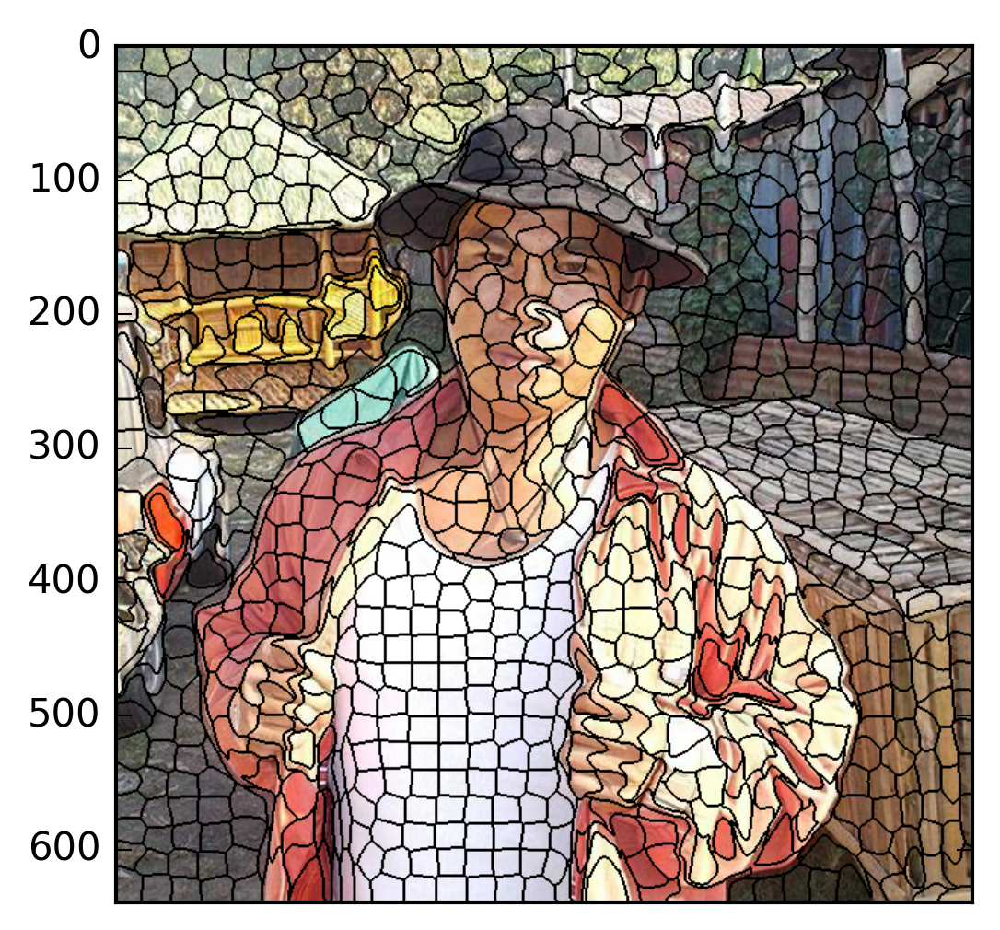

In [21]:
for segs in (10, 50, 100, 300, 500, 1000):
    segments = slic(img, n_segments = segs, sigma = 4)
    fig = plt.figure(figsize=(12,4), dpi=300)
    #ax = fig.add_axes([0, 0, 1, 1])
    plt.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
    #plt.tick_params(axis='Y',which='both',bottom='off',top='off',labelbottom='off') 
    imshow(mark_boundaries(img, segments, (0,0,0)))
plt.show()

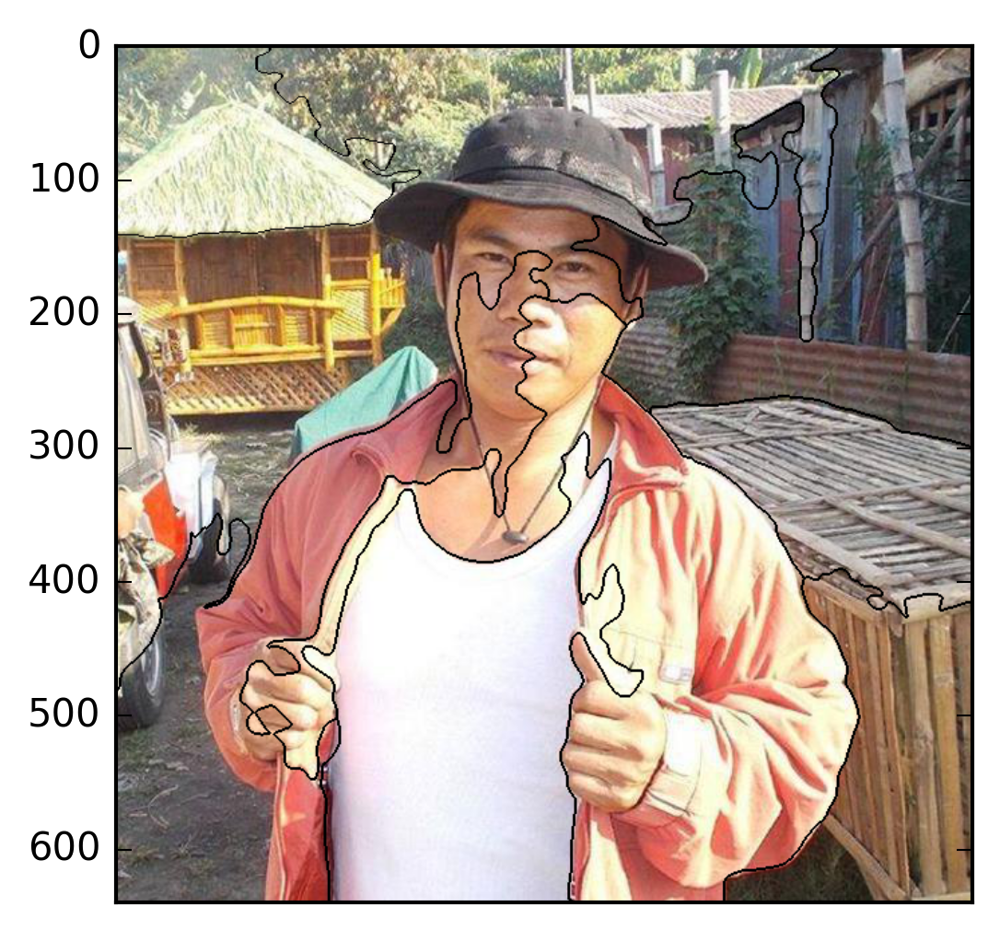

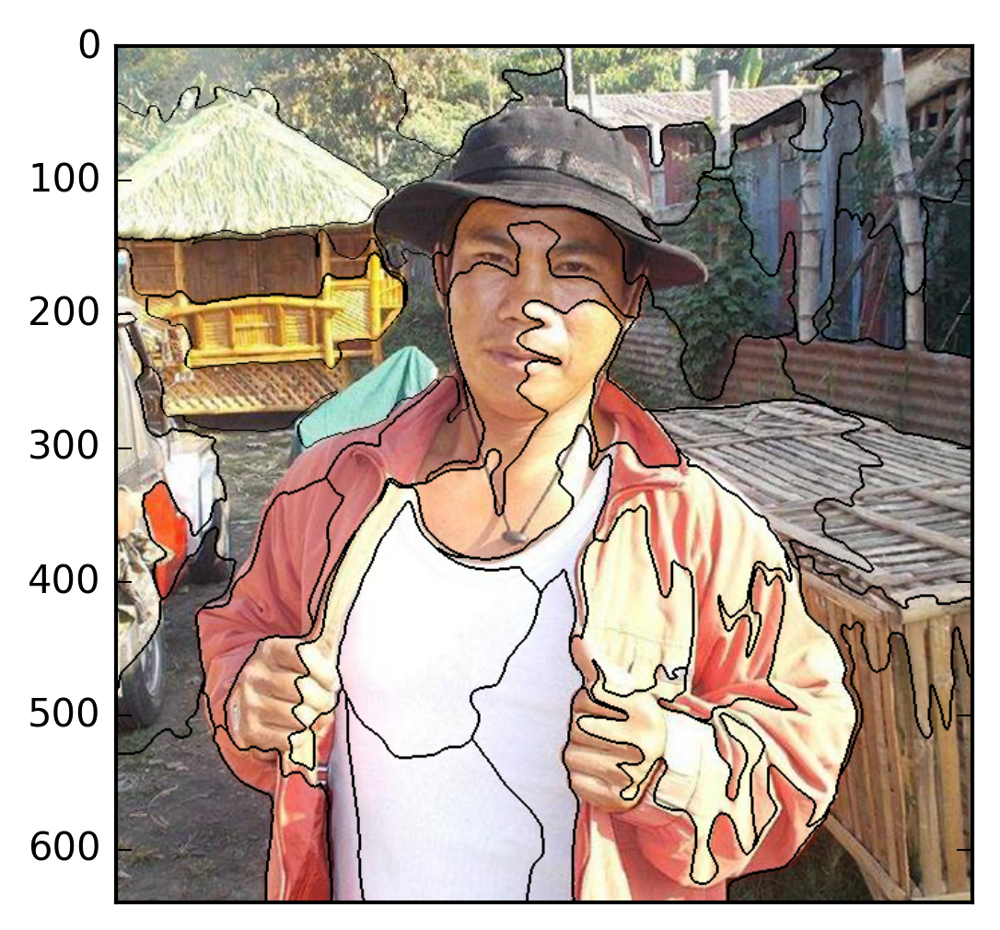

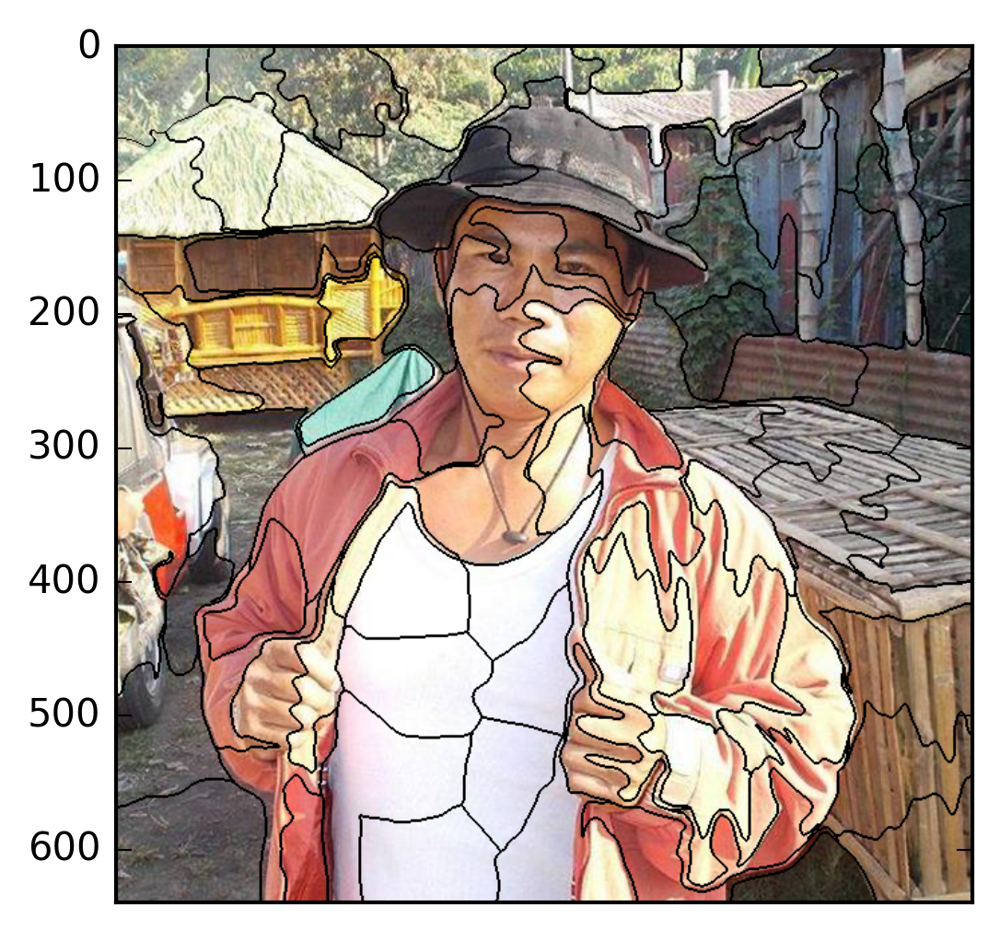

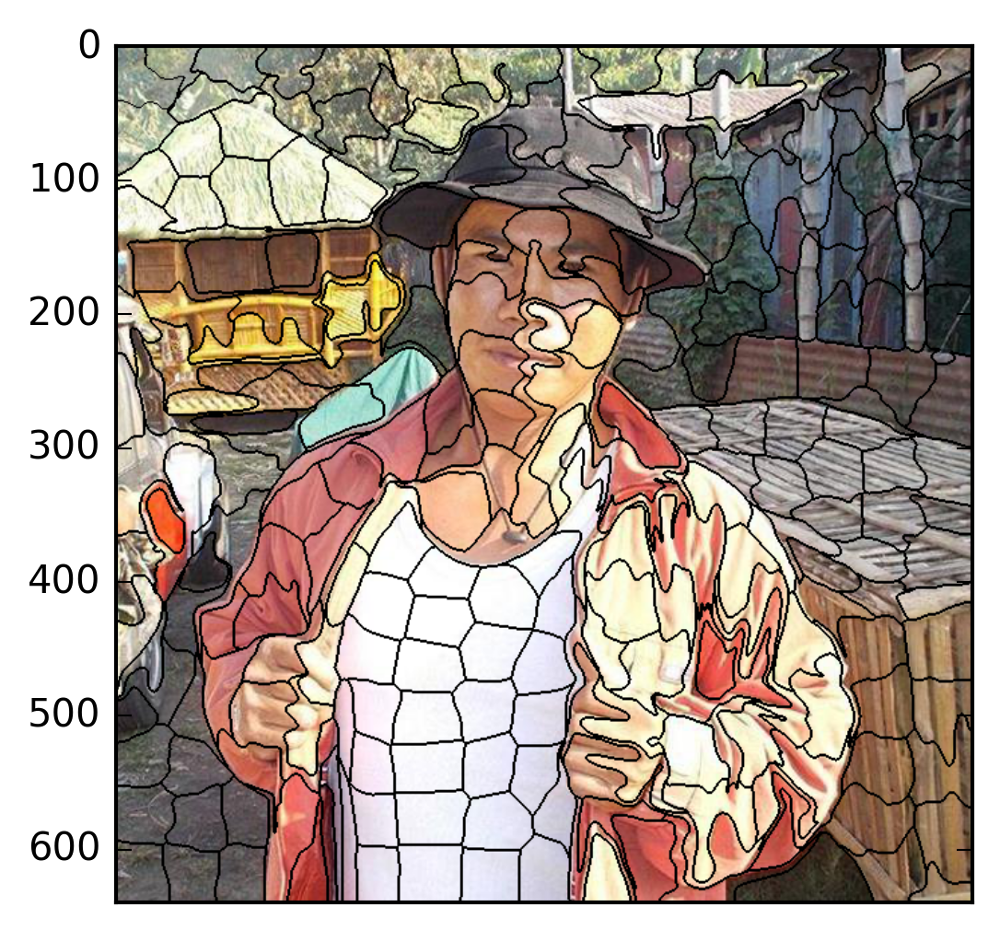

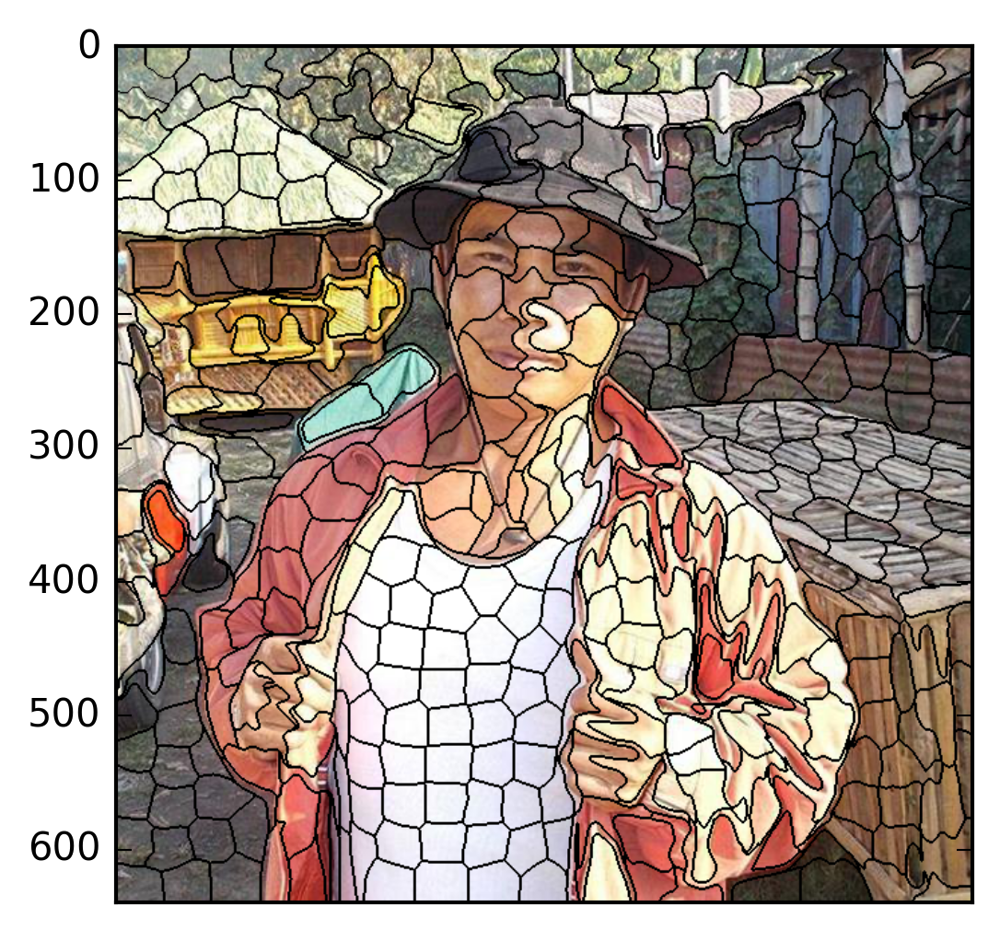

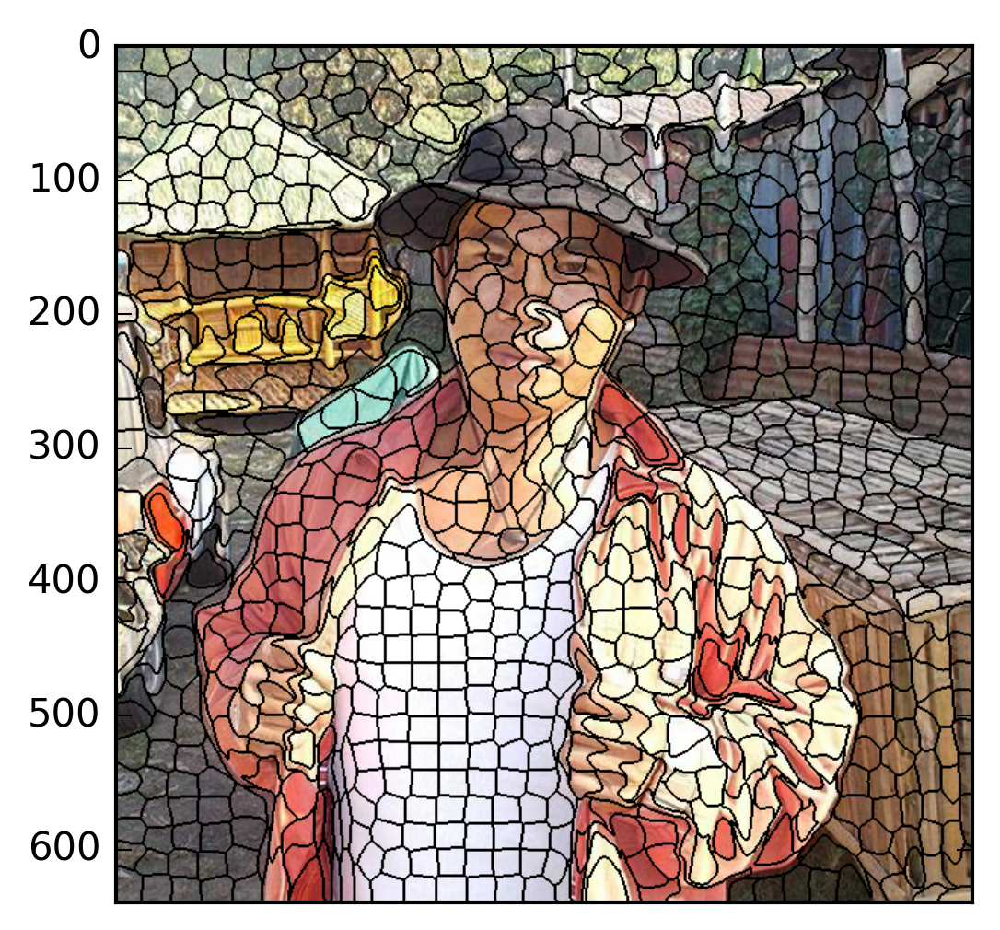

In [22]:
for segs in (10, 50, 100, 300, 500, 1000):
    segments = slic(img, n_segments = segs, sigma = 4)
    fig = plt.figure(figsize=(12,4), dpi=300)
    #ax = fig.add_axes([0, 0, 1, 1])
    plt.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
    #plt.tick_params(axis='Y',which='both',bottom='off',top='off',labelbottom='off') 
    imshow(mark_boundaries(img, segments, (0,0,0)))
plt.show()


Felzenszwalb's number of segments: 1303
Slic number of segments: 188
Quickshift number of segments: 1858


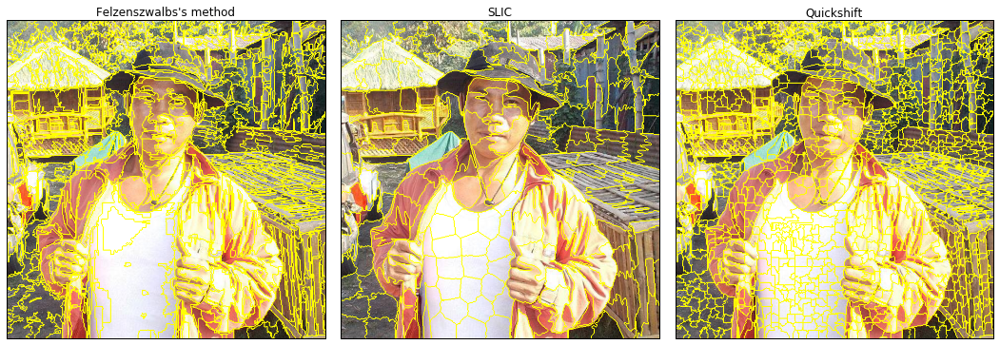

In [23]:
from __future__ import print_function

import matplotlib.pyplot as plt
import numpy as np

from skimage.data import astronaut
from skimage.segmentation import felzenszwalb, slic, quickshift
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float

segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
segments_slic = slic(img, n_segments=250, compactness=10, sigma=1)
segments_quick = quickshift(img, kernel_size=3, max_dist=6, ratio=0.5)

print("Felzenszwalb's number of segments: %d" % len(np.unique(segments_fz)))
print("Slic number of segments: %d" % len(np.unique(segments_slic)))
print("Quickshift number of segments: %d" % len(np.unique(segments_quick)))

fig, ax = plt.subplots(1, 3)
fig.set_size_inches(16, 8, forward=True)
fig.subplots_adjust(0.05, 0.05, 0.95, 0.95, 0.05, 0.05)

ax[0].imshow(mark_boundaries(img, segments_fz))
ax[0].set_title("Felzenszwalbs's method")
ax[1].imshow(mark_boundaries(img, segments_slic))
ax[1].set_title("SLIC")
ax[2].imshow(mark_boundaries(img, segments_quick))
ax[2].set_title("Quickshift")
for a in ax:
    a.set_xticks(())
    a.set_yticks(())
plt.show()

Populating the interactive namespace from numpy and matplotlib


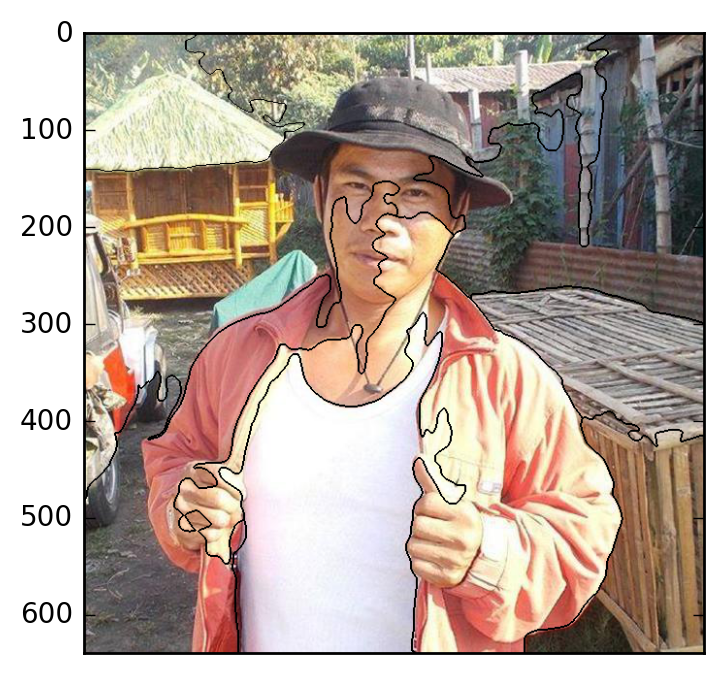

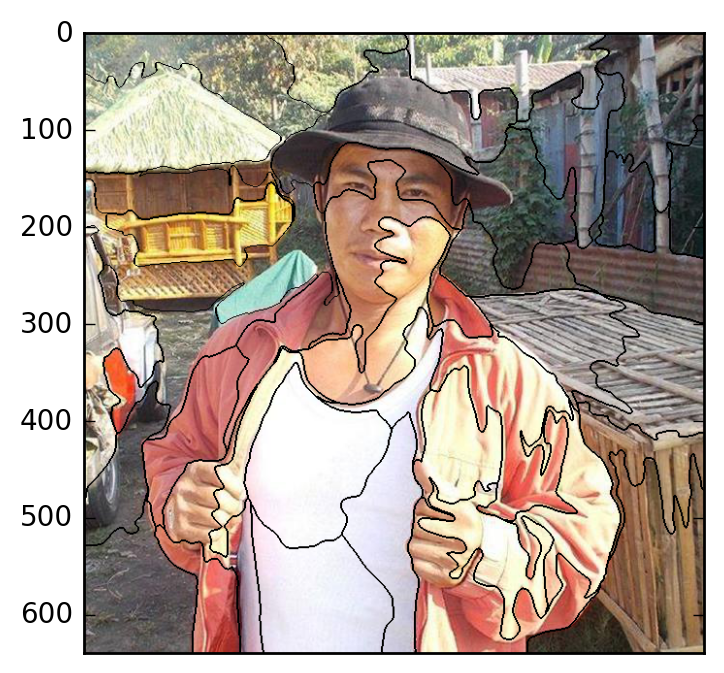

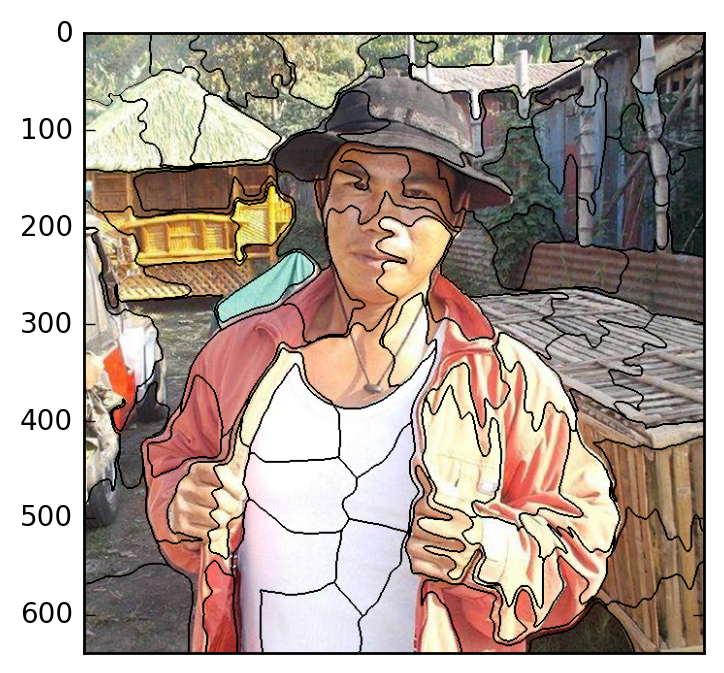

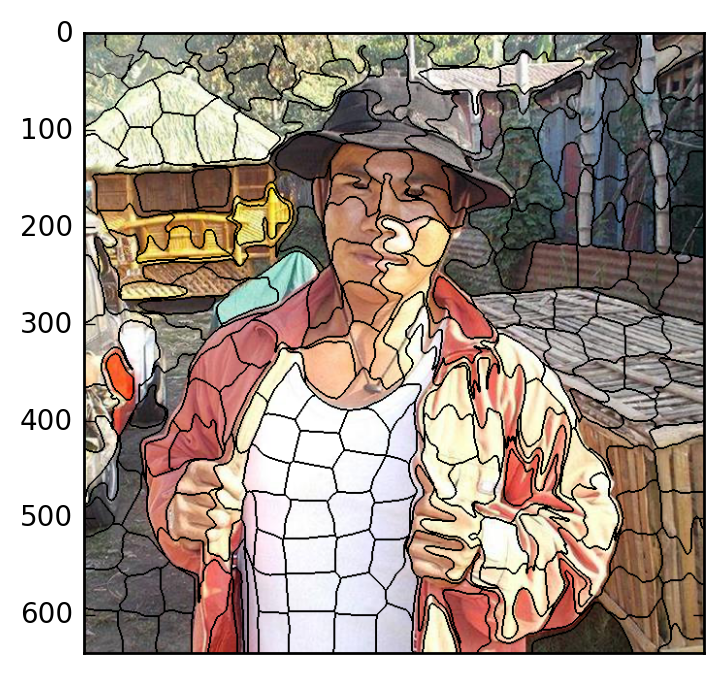

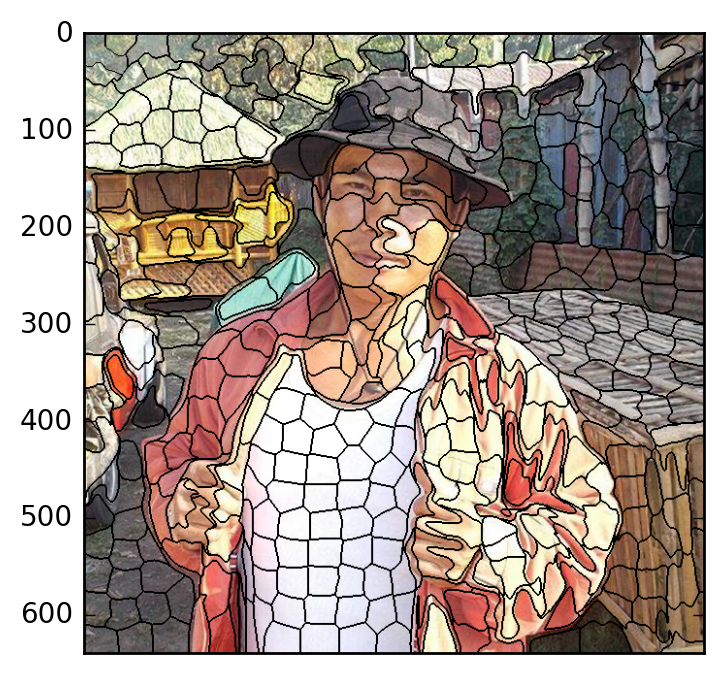

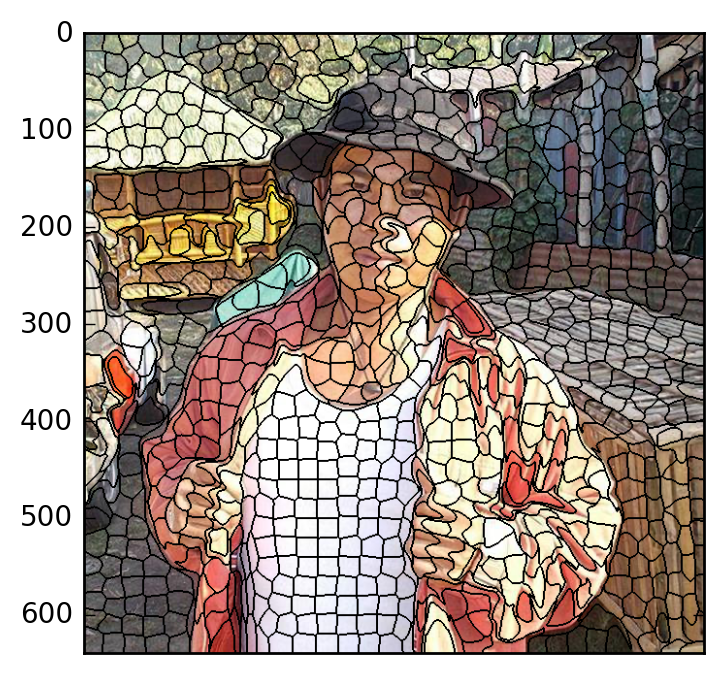

In [24]:
import matplotlib.pyplot as plt
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io

%pylab inline
%matplotlib inline 
img = img_as_float(io.imread('images/003.jpg'))
#io.imshow(img);
for segs in (10, 50, 100, 300, 500, 1000):
    segments = slic(img, n_segments = segs, sigma = 4)
    fig = plt.figure(figsize=(12,4), dpi=200)
    #ax = fig.add_axes([0, 0, 1, 1])
    plt.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
    #plt.tick_params(axis='Y',which='both',bottom='off',top='off',labelbottom='off') 
    imshow(mark_boundaries(img, segments, (0,0,0)))
plt.show()

In [25]:
from PIL import Image
img = Image.open("photos/0028xxx.jpg") 
img = img.convert("RGB")
img.save("photos/0028RGBxxx.jpg")

Populating the interactive namespace from numpy and matplotlib


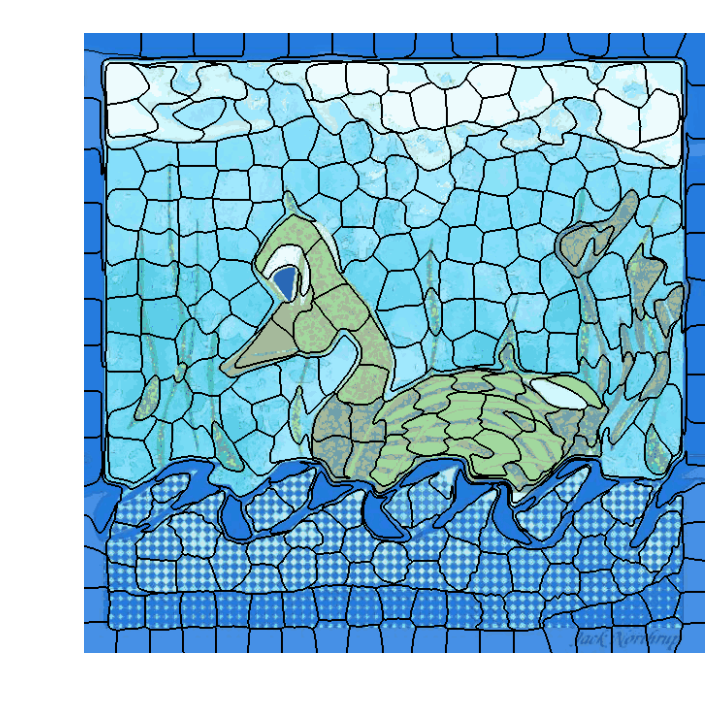

In [27]:
import matplotlib.pyplot as plt
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
from PIL import Image, ImageChops
%pylab inline
%matplotlib inline 
def trim(im):
    bg = Image.new(im.mode, im.size, im.getpixel((0,0)))
    diff = ImageChops.difference(im, bg)
    diff = ImageChops.add(diff, diff, 2.0, -100)
    bbox = diff.getbbox()
    if bbox:
        return im.crop(bbox)

img = Image.open("photos/0028RGBxxx.jpg")    
img = img.convert('P', palette=Image.ADAPTIVE, colors=36)    
img.save("junk/003a.png")    
   
img = img_as_float(io.imread('junk/003a.png'))



#io.imshow(img);
segs = 360
segments = slic(img, n_segments = segs, sigma = 4)
fig = plt.figure(figsize=(12,4), dpi=200)
#ax = fig.add_axes([0, 0, 1, 1])
#plt.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
#plt.tick_params(axis='Y',which='both',bottom='off',top='off',labelbottom='off') 
plt.axis('off')
imshow(mark_boundaries(img, segments, (0,0,0)))
plt.savefig("junk/test2.png", bbox_inches='tight')
im = Image.open("junk/test2.png")
im = trim(im)
im.resize((640,640), Image.NEAREST)
im = im.convert("RGB")
im.save('junk/coffee002.jpg')
im.show()

Populating the interactive namespace from numpy and matplotlib


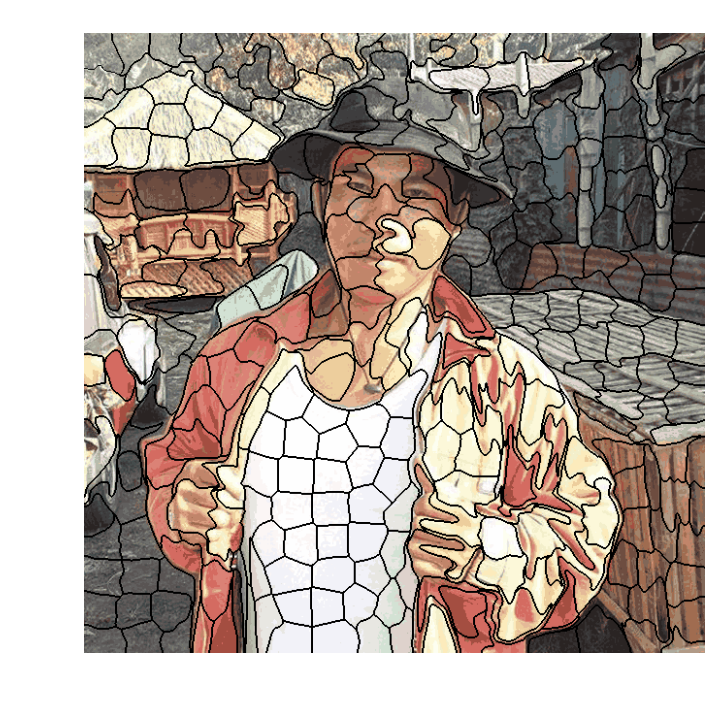

In [28]:
import matplotlib.pyplot as plt
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
from PIL import Image
%pylab inline
%matplotlib inline 
def trim(im):
    bg = Image.new(im.mode, im.size, im.getpixel((0,0)))
    diff = ImageChops.difference(im, bg)
    diff = ImageChops.add(diff, diff, 2.0, -100)
    bbox = diff.getbbox()
    if bbox:
        return im.crop(bbox)

img = Image.open("images/003.jpg")    
img = img.convert('P', palette=Image.ADAPTIVE, colors=36)    
img.save("images/003a.png")    
   
img = img_as_float(io.imread('images/003a.png'))



#io.imshow(img);
segs = 360
segments = slic(img, n_segments = segs, sigma = 4)
fig = plt.figure(figsize=(12,4), dpi=200)
#ax = fig.add_axes([0, 0, 1, 1])
#plt.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
#plt.tick_params(axis='Y',which='both',bottom='off',top='off',labelbottom='off') 
plt.axis('off')
imshow(mark_boundaries(img, segments, (0,0,0)))
plt.savefig("images/test2a.png", bbox_inches='tight')
im = Image.open("images/test2a.png")
im = trim(im)
im.resize((640,640), Image.NEAREST)
im = im.convert("RGB")
im.save('images/test2B.jpg')
im.show()

Populating the interactive namespace from numpy and matplotlib


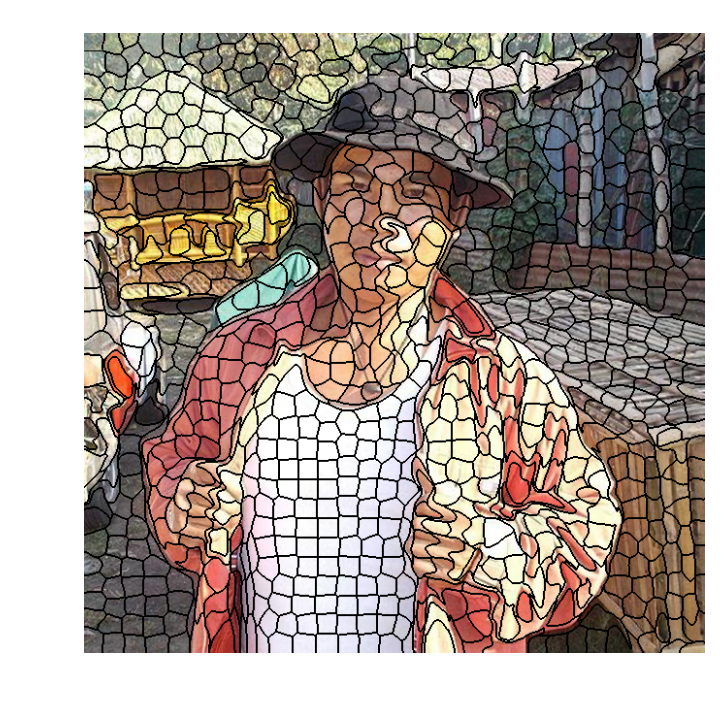

In [29]:
import matplotlib.pyplot as plt
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
from PIL import Image
%pylab inline
%matplotlib inline 
def trim(im):
    bg = Image.new(im.mode, im.size, im.getpixel((0,0)))
    diff = ImageChops.difference(im, bg)
    diff = ImageChops.add(diff, diff, 2.0, -100)
    bbox = diff.getbbox()
    if bbox:
        return im.crop(bbox)
    
img = img_as_float(io.imread('images/003.jpg'))
#io.imshow(img);
segs = 1000
segments = slic(img, n_segments = segs, sigma = 4)
fig = plt.figure(figsize=(12,4), dpi=200)
#ax = fig.add_axes([0, 0, 1, 1])
#plt.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
#plt.tick_params(axis='Y',which='both',bottom='off',top='off',labelbottom='off') 
plt.axis('off')
imshow(mark_boundaries(img, segments, (0,0,0)))
plt.savefig("images/test3.png", bbox_inches='tight')
im = Image.open("images/test3.png")
im = trim(im)
im.resize((640,640), Image.NEAREST)
im = im.convert("RGB")
im.save('images/test2C.jpg')
im.show()

(311, 310)


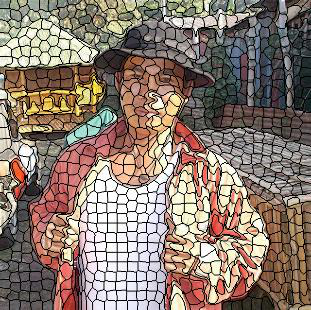

In [33]:
from PIL import Image
im=Image.open("images/test2C.jpg")
print (im.size)
im

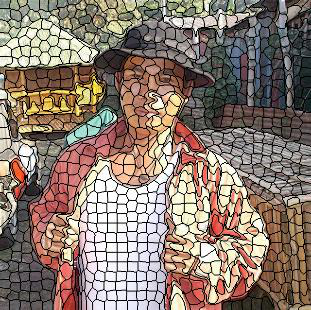

In [39]:
from PIL import Image
im=Image.open("images/test2C.jpg")
im.size
im.getbbox()
im2=im.crop(im.getbbox())
im2.size
im2

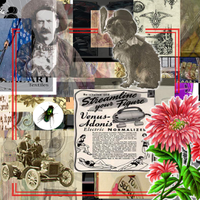

In [38]:
from PIL import Image, ImageChops

def trim(im, border):
    bg = Image.new(im.mode, im.size, border)
    diff = ImageChops.difference(im, bg)
    bbox = diff.getbbox()
    if bbox:
        return im.crop(bbox)

def create_thumbnail(path, xsize,ysize):
    image = Image.open(path)
    name, extension = path.split('.')
    options = {}
    if 'transparency' in image.info:
        options['transparency'] = image.info["transparency"]
  
    image.thumbnail((xsize, ysize), Image.ANTIALIAS)
    image = trim(image, 255) ## Trim whitespace
    image.save(name + '_new.' + extension, **options)
    return image


create_thumbnail('photos/38.jpg', 200, 200)

# Trims off the white border

In [40]:
from PIL import Image, ImageChops

def trim(im):
    bg = Image.new(im.mode, im.size, im.getpixel((0,0)))
    diff = ImageChops.difference(im, bg)
    diff = ImageChops.add(diff, diff, 2.0, -100)
    bbox = diff.getbbox()
    if bbox:
        return im.crop(bbox)

im = Image.open("photos/38.jpg")
im = trim(im)
im = im.resize((640,640), Image.NEAREST)
im.show()


In [44]:
from PIL import Image, ImageChops

def trim(im):
    bg = Image.new(im.mode, im.size, im.getpixel((0,0)))
    diff = ImageChops.difference(im, bg)
    diff = ImageChops.add(diff, diff, 2.0, -100)
    bbox = diff.getbbox()
    if bbox:
        return im.crop(bbox)

im = Image.open("photos/38.jpg")
im = trim(im)
im = im.resize((640,640), Image.NEAREST)
im.show()

In [49]:
from PIL import Image
im=Image.open("photos/38.jpg")
im.save("photos/38.png")
im2=Image.open("photos/38.png")

im.size
im.getbbox()
im2=im.crop(im.getbbox())
im2.size

(1040, 1040)

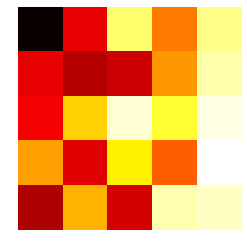

In [50]:
from numpy import random
import matplotlib.pyplot as plt

data = random.random((5,5))
img = plt.imshow(data, interpolation='nearest')
img.set_cmap('hot')
plt.axis('off')
plt.savefig("test.png", bbox_inches='tight')

Populating the interactive namespace from numpy and matplotlib


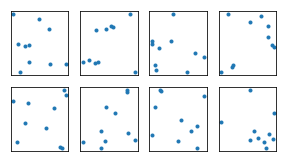

In [19]:
import matplotlib.pyplot as plt
import numpy as np
%pylab inline
%matplotlib inline 

ncols = 5
nrows = 3

# create the plots
fig = plt.figure()
axes = [ fig.add_subplot(nrows, ncols, r * ncols + c) for r in range(1, nrows) for c in range(1, ncols) ]

# add some data
for ax in axes:
    ax.plot(np.random.random(10), np.random.random(10), '.')

# remove the x and y ticks
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])

In [ ]:
def autocrop_image2(image):
    image_data = np.asarray(image)
    image_data_bw = image_data[:,:,3]
    non_empty_columns = np.where(image_data_bw.max(axis=0) > 0)[0]
    non_empty_rows = np.where(image_data_bw.max(axis=1) > 0)[0]
    cropBox = (min(non_empty_rows), max(non_empty_rows),
               min(non_empty_columns), max(non_empty_columns))

    image_data_new = image_data[cropBox[0]:cropBox[
        1] + 1, cropBox[2]:cropBox[3] + 1, :]

    new_image = Image.fromarray(image_data_new)
    return new_image

from PIL import Image
im=Image.open("test2.png")
bbox = im.convert("RGBa").getbbox()
im0 = autocrop_image2(bbox)
im0

In [120]:
!locate override.css

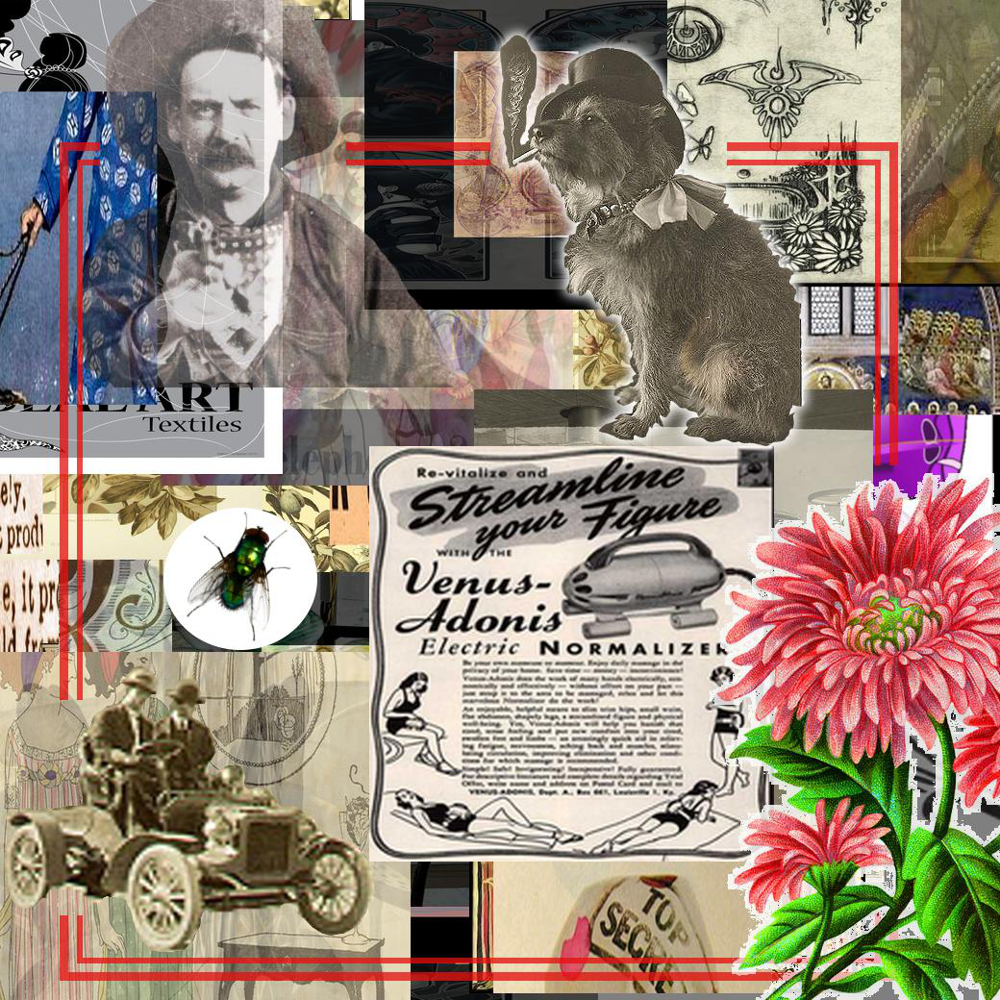

In [56]:
im=Image.open("photos/38.jpg")
bbox = im.convert("RGBA")
bbox

In [59]:
from PIL import Image
import numpy as np
def autocrop_image2(image):
    #image.load()
    image_data = np.asarray(image)
    image_data_bw = image_data.max(axis=2)
    non_empty_columns = np.where(image_data_bw.max(axis=0) > 0)[0]
    non_empty_rows = np.where(image_data_bw.max(axis=1) > 0)[0]
    cropBox = (min(non_empty_rows), max(non_empty_rows),
               min(non_empty_columns), max(non_empty_columns))

    image_data_new = image_data[cropBox[0]:cropBox[
        1] + 1, cropBox[2]:cropBox[3] + 1, :]

    new_image = Image.fromarray(image_data_new)
    return new_image
im=Image.open("photos/38.png")
bbox = im.convert("RGBA").getbbox()
im0 = autocrop_image2(bbox)
im0

AxisError: axis 2 is out of bounds for array of dimension 1

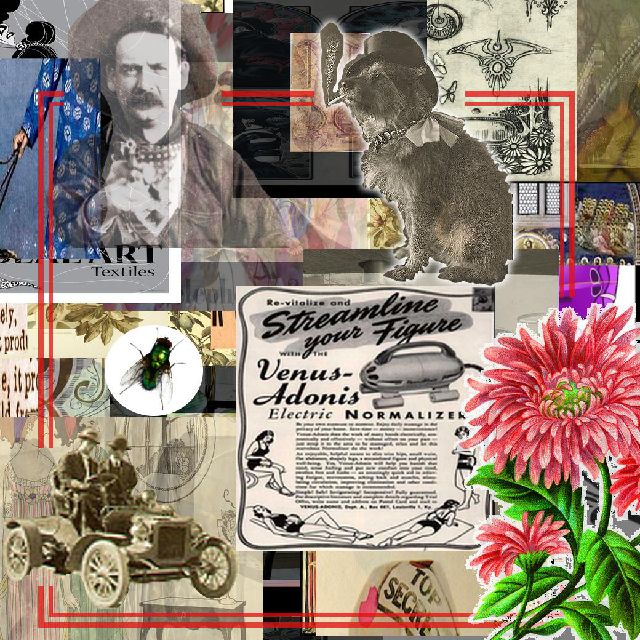

In [61]:
im = Image.open("photos/38.jpg")
im = im.resize((640,640), Image.NEAREST)
im.save("photos/38.png")
im

In [64]:
# import the necessary packages
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import argparse
import utils
import cv2
def clust(IMAGE):
    # construct the argument parser and parse the arguments
    # load the image and convert it from BGR to RGB so that
    # we can dispaly it with matplotlib
    image = cv2.imread(IMAGE)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # show our image
    return image
    
IMAGE = "photos/38.png"    
im = clust(IMAGE)

cv2.imwrite("photos/38CLUST.png", im)

True

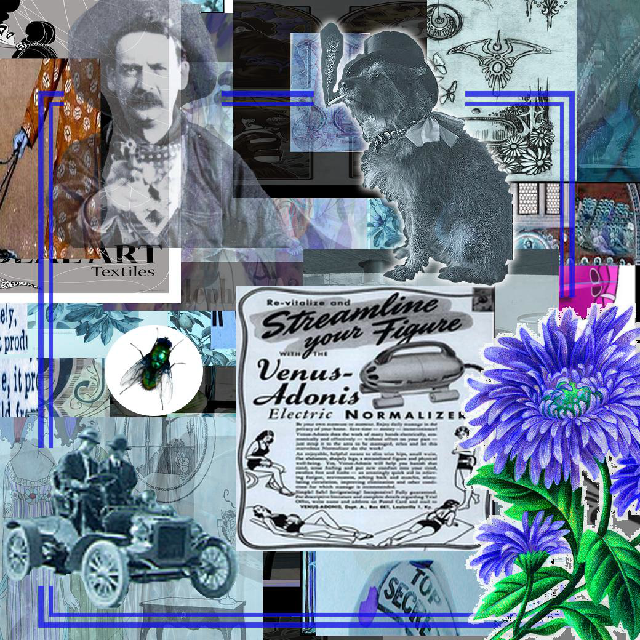

In [65]:
from PIL import Image
imN= Image.open("photos/38CLUST.png")
imN

# Creating Text for video

In [200]:
import markdown
class MD(str):
    def _repr_html_(self):
        return markdown.markdown(self)
    
STR="""
<div style ="border:1px solid red;padding:15px;">    
<h3>Help on function mark_boundaries in module skimage.segmentation.boundaries:</h3>

<p style = "color:blue">mark_boundaries(image, label_img, color=(1, 1, 0), outline_color=None, mode='outer', background_label=0)
Return image with boundaries between labeled regions highlighted.</p>
Parameters
----------<pre>
    image : (M, N[, 3]) array
        Grayscale or RGB image.
    label_img : (M, N) array of int
        Label array where regions are marked by different integer values.
    color : length-3 sequence, optional
        RGB color of boundaries in the output image.
    outline_color : length-3 sequence, optional
        RGB color surrounding boundaries in the output image. If None, no
        outline is drawn.
    mode : string in {'thick', 'inner', 'outer', 'subpixel'}, optional
        The mode for finding boundaries.
    background_label : int, optional
        Which label to consider background (this is only useful for
        modes ``inner`` and ``outer``).
</pre>    
Returns
-------
    marked : (M, N, 3) array of float
        An image in which the boundaries between labels are
        superimposed on the original image.
</div>
"""
MD(STR)    

'\n<div style ="border:1px solid red;padding:15px;">    \n<h3>Help on function mark_boundaries in module skimage.segmentation.boundaries:</h3>\n\n<p style = "color:blue">mark_boundaries(image, label_img, color=(1, 1, 0), outline_color=None, mode=\'outer\', background_label=0)\nReturn image with boundaries between labeled regions highlighted.</p>\nParameters\n----------<pre>\n    image : (M, N[, 3]) array\n        Grayscale or RGB image.\n    label_img : (M, N) array of int\n        Label array where regions are marked by different integer values.\n    color : length-3 sequence, optional\n        RGB color of boundaries in the output image.\n    outline_color : length-3 sequence, optional\n        RGB color surrounding boundaries in the output image. If None, no\n        outline is drawn.\n    mode : string in {\'thick\', \'inner\', \'outer\', \'subpixel\'}, optional\n        The mode for finding boundaries.\n    background_label : int, optional\n        Which label to consider background (this is only useful for\n        modes ``inner`` and ``outer``).\n</pre>    \nReturns\n-------\n    marked : (M, N, 3) array of float\n        An image in which the boundaries between labels are\n        superimposed on the original image.\n</div>\n'

In [118]:
!ls ~/.jupyter/custom

current_theme.txt  fonts


In [ ]:
# %load ~/.jupyter/custom/current_theme.txt
monokai

In [150]:
!python color_kmeans.py --image 003.jpg --clusters 3

  File "color_kmeans.py", line 10
    %pylab inline
    ^
SyntaxError: invalid syntax


In [69]:
%%writefile utilz.py
# import the necessary packages
import numpy as np
import cv2

def centroid_histogram(clt):
    # grab the number of different clusters and create a histogram
    # based on the number of pixels assigned to each cluster
    numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
    (hist, _) = np.histogram(clt.labels_, bins = numLabels)

    # normalize the histogram, such that it sums to one
    hist = hist.astype("float")
    hist /= hist.sum()

    # return the histogram
    return hist

def plot_colors(hist, centroids):
    # initialize the bar chart representing the relative frequency
    # of each of the colors
    bar = np.zeros((50, 300, 3), dtype = "uint8")
    startX = 0

    # loop over the percentage of each cluster and the color of
    # each cluster
    for (percent, color) in zip(hist, centroids):
        # plot the relative percentage of each cluster
        endX = startX + (percent * 300)
        cv2.rectangle(bar, (int(startX), 0), (int(endX), 50),
            color.astype("uint8").tolist(), -1)
        startX = endX

    # return the bar chart
    return bar

Overwriting utilz.py


Populating the interactive namespace from numpy and matplotlib


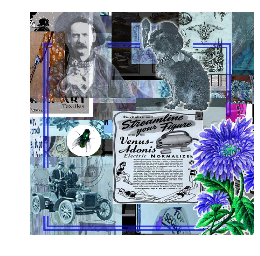

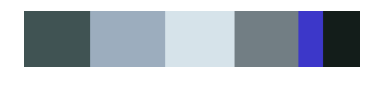

In [71]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import argparse
import numpy as np
import utilz
import cv2
%pylab inline
%matplotlib inline 
def centroid_histogram(clt):
    # grab the number of different clusters and create a histogram
    # based on the number of pixels assigned to each cluster
    numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
    (hist, _) = np.histogram(clt.labels_, bins = numLabels)

    # normalize the histogram, such that it sums to one
    hist = hist.astype("float")
    hist /= hist.sum()

    # return the histogram
    return hist

def plot_colors(hist, centroids):
    # initialize the bar chart representing the relative frequency
    # of each of the colors
    bar = np.zeros((50, 300, 3), dtype = "uint8")
    startX = 0

    # loop over the percentage of each cluster and the color of
    # each cluster
    for (percent, color) in zip(hist, centroids):
        # plot the relative percentage of each cluster
        endX = startX + (percent * 300)
        cv2.rectangle(bar, (int(startX), 0), (int(endX), 50),
            color.astype("uint8").tolist(), -1)
        startX = endX

    # return the bar chart
    return bar

def Clust(iMage, clusters):
    # load the image and convert it from BGR to RGB so that
    # we can dispaly it with matplotlib
    image = cv2.imread(iMage)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # show our image
    plt.figure()
    plt.axis("off")
    plt.imshow(image)

    # reshape the image to be a list of pixels
    image = image.reshape((image.shape[0] * image.shape[1], 3))

    # cluster the pixel intensities
    clt = KMeans(clusters)
    clt.fit(image)

    # build a histogram of clusters and then create a figure
    # representing the number of pixels labeled to each color
    hist = utilz.centroid_histogram(clt)
    bar = utilz.plot_colors(hist, clt.cluster_centers_)

    # show our color bart
    plt.figure()
    plt.axis("off")
    plt.imshow(bar)
    plt.show()

iMage = "photos/38CLUST.png"
clusters = 6
Clust(iMage, clusters)    

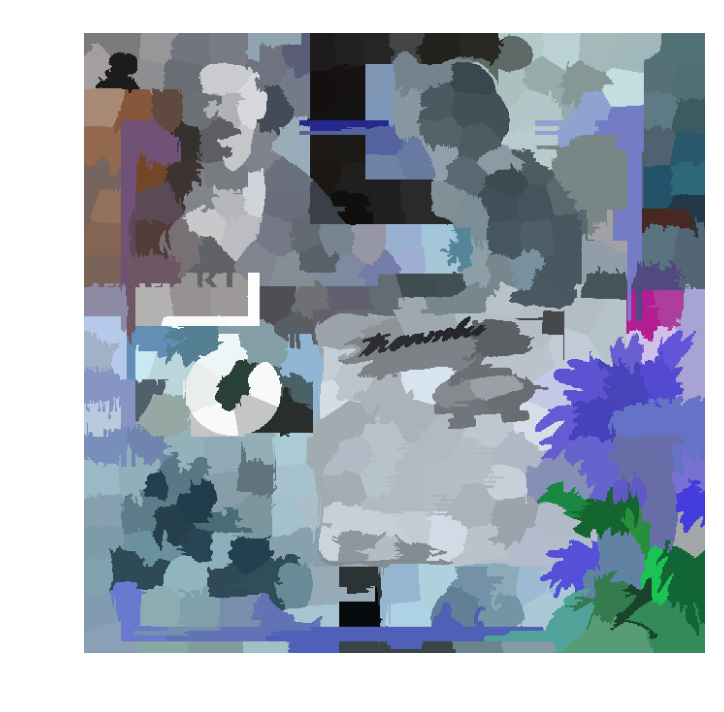

In [72]:
import time
from matplotlib import pyplot as plt
from skimage import future
from skimage import data, segmentation, filters, color, io
from skimage.future import graph
from matplotlib import pyplot as plt

img = io.imread("photos/38CLUST.png")
labels = segmentation.slic(img, compactness=30, n_segments=400)
g = future.graph.rag_mean_color(img, labels)
def weight_boundary(graph, src, dst, n):
    default = {'weight': 0.0, 'count': 0}
    count_src = graph[src].get(n, default)['count']
    count_dst = graph[dst].get(n, default)['count']
    weight_src = graph[src].get(n, default)['weight']
    weight_dst = graph[dst].get(n, default)['weight']
    count = count_src + count_dst
    return {
        'count': count,
        'weight': (count_src * weight_src + count_dst * weight_dst)/count
    }
def merge_boundary(graph, src, dst):
    """Call back called before merging 2 nodes.
    In this case we don't need to do any computation here.""" 
    pass

labels2 = future.graph.merge_hierarchical(labels, g, thresh=0.08, rag_copy=False,
                                   in_place_merge=True,
                                   merge_func=merge_boundary,
                                   weight_func=weight_boundary)

#graph.show_rag(labels, g, img)
#plt.title('RAG after hierarchical merging')
plt.figure(dpi=200)
out = color.label2rgb(labels2, img, kind='avg')
plt.axis("off")
plt.imshow(out)
io.imsave("images/Stest2.png", out)
#plt.title('Final segmentation')

plt.show()    
    

In [73]:
!showme images/Stest2.png

In [74]:
import time
from matplotlib import pyplot as plt
from skimage import future
from skimage import data, segmentation, filters, color
from skimage import graph, data, io
from skimage.future import graph
from matplotlib import pyplot as plt
from PIL import Image, ImageChops

img = io.imread("images/Stest2.png")
labels = segmentation.slic(img, compactness=30, n_segments=400)
g = future.graph.rag_mean_color(img, labels)
def weight_boundary(graph, src, dst, n):
    default = {'weight': 0.0, 'count': 0}
    count_src = graph[src].get(n, default)['count']
    count_dst = graph[dst].get(n, default)['count']
    weight_src = graph[src].get(n, default)['weight']
    weight_dst = graph[dst].get(n, default)['weight']
    count = count_src + count_dst
    return {
        'count': count,
        'weight': (count_src * weight_src + count_dst * weight_dst)/count
    }
def merge_boundary(graph, src, dst):
    """Call back called before merging 2 nodes.
    In this case we don't need to do any computation here.""" 
    pass

labels2 = future.graph.merge_hierarchical(labels, g, thresh=0.08, rag_copy=False,
                                   in_place_merge=True,
                                   merge_func=merge_boundary,
                                   weight_func=weight_boundary)

#graph.show_rag(labels, g, img)
#plt.title('RAG after hierarchical merging')
plt.figure(dpi=200)
out = color.label2rgb(labels2, img, kind='avg')
plt.axis("off")
io.imsave("images/Stest2S.png", out)
IMG =Image.open("images/Stest2S.png")
IMG

KeyError: 'count'

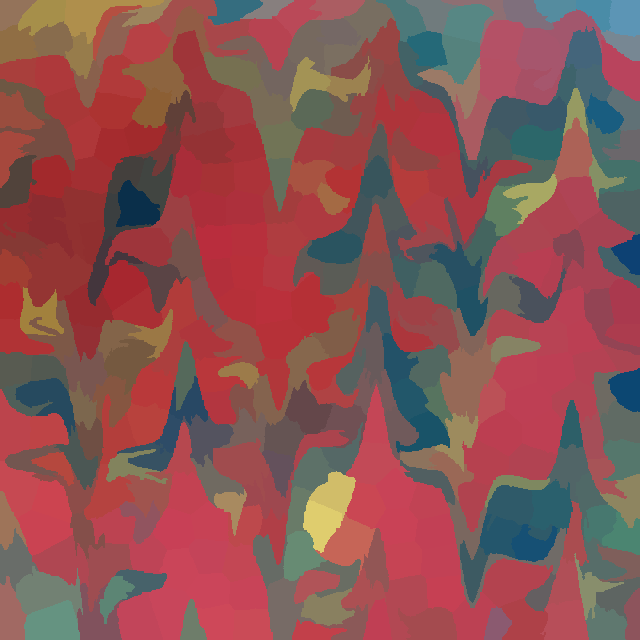

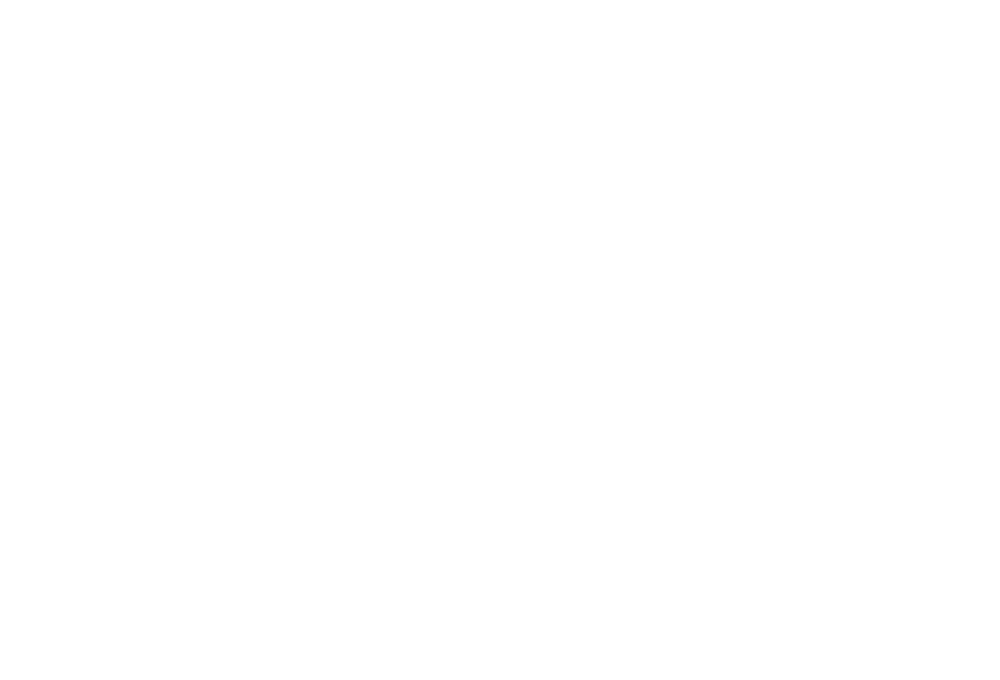

In [75]:
import time
from matplotlib import pyplot as plt
from skimage import future
from skimage import data, segmentation, filters, color
from skimage import graph, data, io
from skimage.future import graph
from matplotlib import pyplot as plt
from PIL import Image, ImageChops

img = io.imread("photos/0147xxx.jpg")
labels = segmentation.slic(img, compactness=30, n_segments=400)
g = future.graph.rag_mean_color(img, labels)
def weight_boundary(graph, src, dst, n):
    default = {'weight': 0.0, 'count': 0}
    count_src = graph[src].get(n, default)['count']
    count_dst = graph[dst].get(n, default)['count']
    weight_src = graph[src].get(n, default)['weight']
    weight_dst = graph[dst].get(n, default)['weight']
    count = count_src + count_dst
    return {
        'count': count,
        'weight': (count_src * weight_src + count_dst * weight_dst)/count
    }
def merge_boundary(graph, src, dst):
    """Call back called before merging 2 nodes.
    In this case we don't need to do any computation here.""" 
    pass

labels2 = future.graph.merge_hierarchical(labels, g, thresh=0.08, rag_copy=False,
                                   in_place_merge=True,
                                   merge_func=merge_boundary,
                                   weight_func=weight_boundary)

#graph.show_rag(labels, g, img)
#plt.title('RAG after hierarchical merging')
plt.figure(dpi=200)
out = color.label2rgb(labels2, img, kind='avg')
plt.axis("off")
io.imsave("images/SStest2.png", out)
IMG =Image.open("images/SStest2.png")
IMG

In [79]:
import time
from matplotlib import pyplot as plt
from skimage import future
from skimage import data, segmentation, filters, color
from skimage import graph, data, io
from skimage.future import graph
from matplotlib import pyplot as plt
from PIL import Image, ImageChops
def main(imgagefile):
    img = io.imread(imgagefile)
    labels = segmentation.slic(img, compactness=30, n_segments=400)
    g = future.graph.rag_mean_color(img, labels)
    def weight_boundary(graph, src, dst, n):
        default = {'weight': 0.0, 'count': 0}
        count_src = graph[src].get(n, default)['count']
        count_dst = graph[dst].get(n, default)['count']
        weight_src = graph[src].get(n, default)['weight']
        weight_dst = graph[dst].get(n, default)['weight']
        count = count_src + count_dst
        return {
            'count': count,
            'weight': (count_src * weight_src + count_dst * weight_dst)/count
        }
    def merge_boundary(graph, src, dst):
        """Call back called before merging 2 nodes.
        In this case we don't need to do any computation here.""" 
        pass

    labels2 = future.graph.merge_hierarchical(labels, g, thresh=0.08, rag_copy=False,
                                       in_place_merge=True,
                                       merge_func=merge_boundary,
                                       weight_func=weight_boundary)
    out = color.label2rgb(labels2, img, kind='avg')
    io.imsave("images/Stest2.png", out)
    IMG =Image.open("images/Stest2.png")
    IMG

In [80]:
im = Image.open("images/Stest2.png")
im = trim(im)
im.resize((640,640), Image.NEAREST)
im = im.convert("RGB")
im.save('images/Stest2.jpg')
im.show()

In [81]:
plt.savefig("images/testZ2.png", bbox_inches='tight')
im = Image.open("images/testZ2.png")
im = trim(im)
im.resize((640,640), Image.NEAREST)
im = im.convert("RGB")
im.save('test2.jpg')
im.show()

AttributeError: 'NoneType' object has no attribute 'resize'

In [ ]:
from PIL import Image, ImageChops

def trim(im):
    bg = Image.new(im.mode, im.size, im.getpixel((0,0)))
    diff = ImageChops.difference(im, bg)
    diff = ImageChops.add(diff, diff, 2.0, -100)
    bbox = diff.getbbox()
    if bbox:
        return im.crop(bbox)

im = Image.open("coffee002.jpg")
im = trim(im)
im = im.resize((640,640), Image.NEAREST)
im.show()

In [ ]:
%%writefile utils.py
# import the necessary packages
import numpy as np
import cv2
 
def centroid_histogram(clt):
	# grab the number of different clusters and create a histogram
	# based on the number of pixels assigned to each cluster
	numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
	(hist, _) = np.histogram(clt.labels_, bins = numLabels)
 
	# normalize the histogram, such that it sums to one
	hist = hist.astype("float")
	hist /= hist.sum()
 
	# return the histogram
	return hist